In [1]:
import pandas as pd
import json
import cv2
import matplotlib.pyplot as plt
import seaborn as sns

In [86]:
train_json_path = '/opt/ml/detection/dataset/train.json'
with open(train_json_path,'r') as j:
    train=json.loads(j.read())
    
annotations = train['annotations']
images_info = train['images']

annotation_df = pd.DataFrame(annotations) #annotation데이터
images_info_df = pd.DataFrame(images_info) #image파일명 데이터

images_info_df = images_info_df.rename(columns={"id": "image_id"})
images_info_df = images_info_df[['file_name', 'image_id']] #파일명과 image_id만

data = annotation_df.merge(images_info_df, how='left', on='image_id')

In [87]:
data.head()

,image_id,category_id,area,bbox,iscrowd,id,file_name
0,0,0,257301.66,"[197.6, 193.7, 547.8, 469.7]",0,0,train/0000.jpg
1,1,3,10402.56,"[0.0, 407.4, 57.6, 180.6]",0,1,train/0001.jpg
2,1,7,26259.36,"[0.0, 455.6, 144.6, 181.6]",0,2,train/0001.jpg
3,1,4,69096.17,"[722.3, 313.4, 274.3, 251.9]",0,3,train/0001.jpg
4,1,5,24164.58,"[353.2, 671.0, 233.7, 103.4]",0,4,train/0001.jpg


In [4]:
def read_image(dataset_path, file_path):
    '''
    이미지를 opencv로 읽는 함수입니다.
    '''
    image = cv2.imread(dataset_path + file_path, cv2.IMREAD_COLOR)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)# opencv convention BGR -> matplot convention RGB
    return image

def plot_bbox(image, anns, image_id):
    for ann in anns:
        ann # '[0.0, 407.4, 57.6, 180.6]'를 [0.0, 407.4, 57.6, 180.6]로 변환
        xmin, ymin, w, h = map(int, ann)
        image = cv2.rectangle(image, (xmin, ymin), (xmin + w, ymin + h), (0, 0, 255), 3)
    plt.imshow(image)
    plt.title(f'id={image_id}, ({len(anns)} boxes)', fontsize=14) # 이미지당 annot개수 표시
    
def get_annotations(df, image_num):
    image_df = df[df['image_id'] == image_num]
    anns = image_df.bbox.values.tolist()
    #anns = [ann for ann in df['bbox'] if df['image_id'] == image_num]
    return anns

In [5]:
dataset_path = '/opt/ml/detection/dataset/'

In [6]:
def image_with_bbox_by_12_id(sample_id):
    '''
    sample_id : id 입력 (예) range(12)
    
    12개의 sample id에 대해 bbox가 그려진 이미지를 시각화합니다.
    이미지의 title은 bbox의 개수입니다.
    '''
    fig = plt.figure(figsize=(24,20))
    for i, image_id in enumerate(sample_id):
        ax = fig.add_subplot(3, 4, i+1)
        id_len = len(str(image_id)) 
        image = read_image(dataset_path, 'train/'+'0'*(4-id_len)+str(image_id)+'.jpg')
        anns = get_annotations(data, image_id)
        plot_bbox(image, anns, image_id)

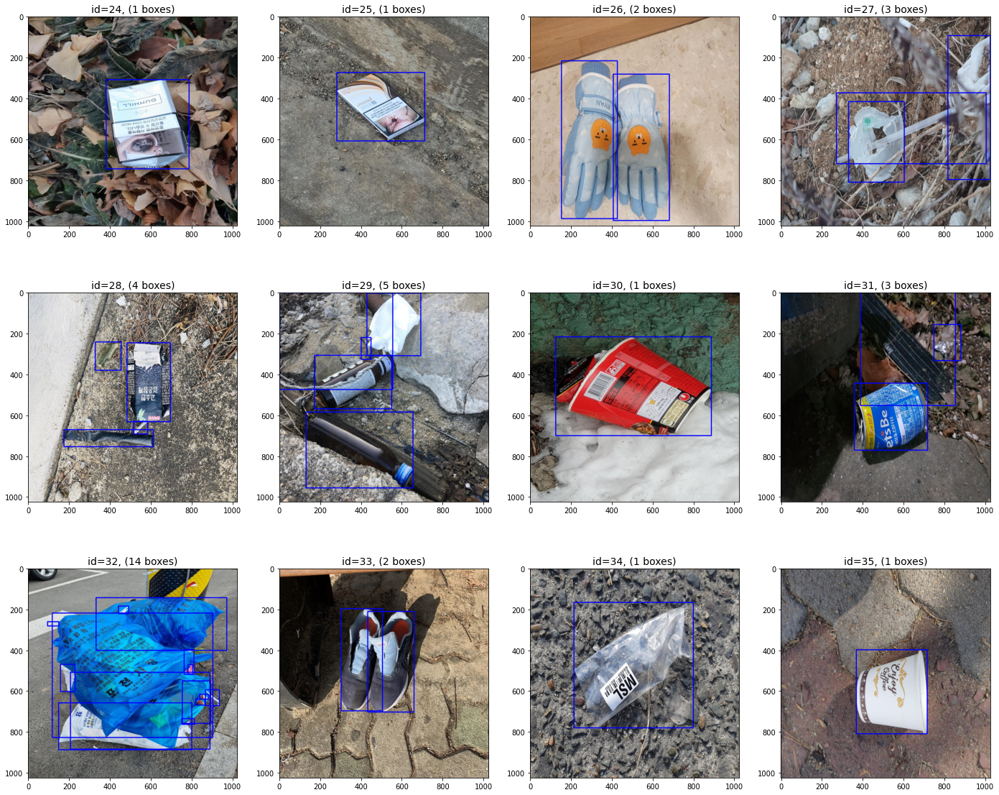

In [66]:
sample_id = range(24,36)
image_with_bbox_by_12_id(sample_id)

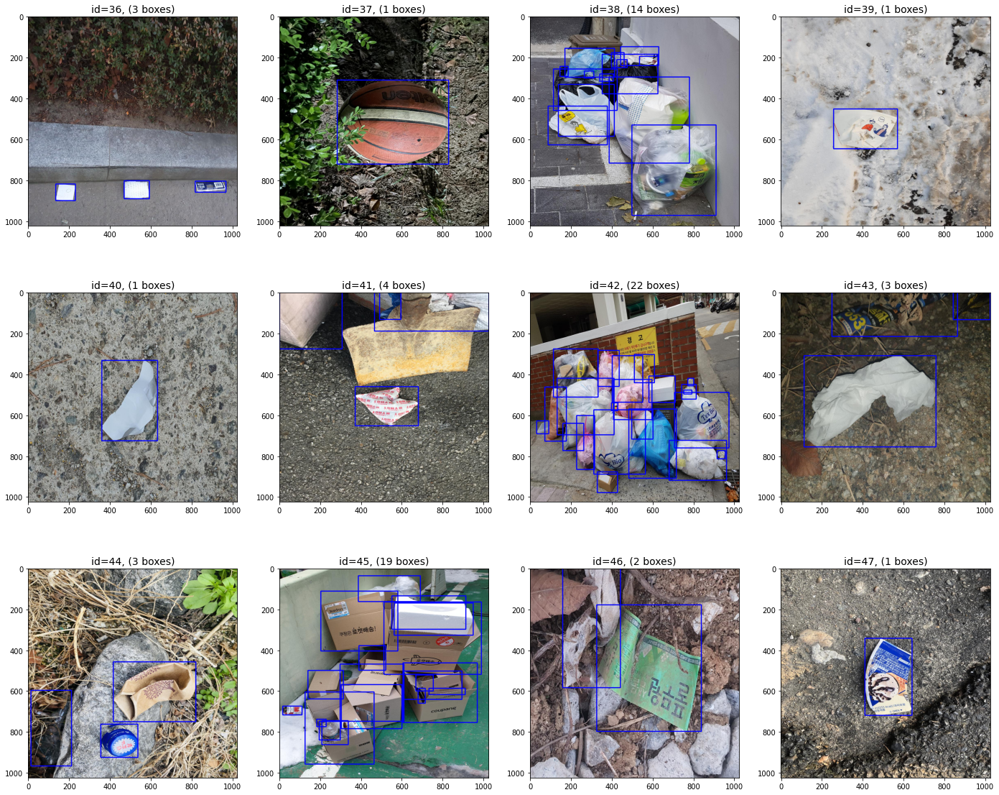

In [67]:
sample_id = range(36,48)
image_with_bbox_by_12_id(sample_id)

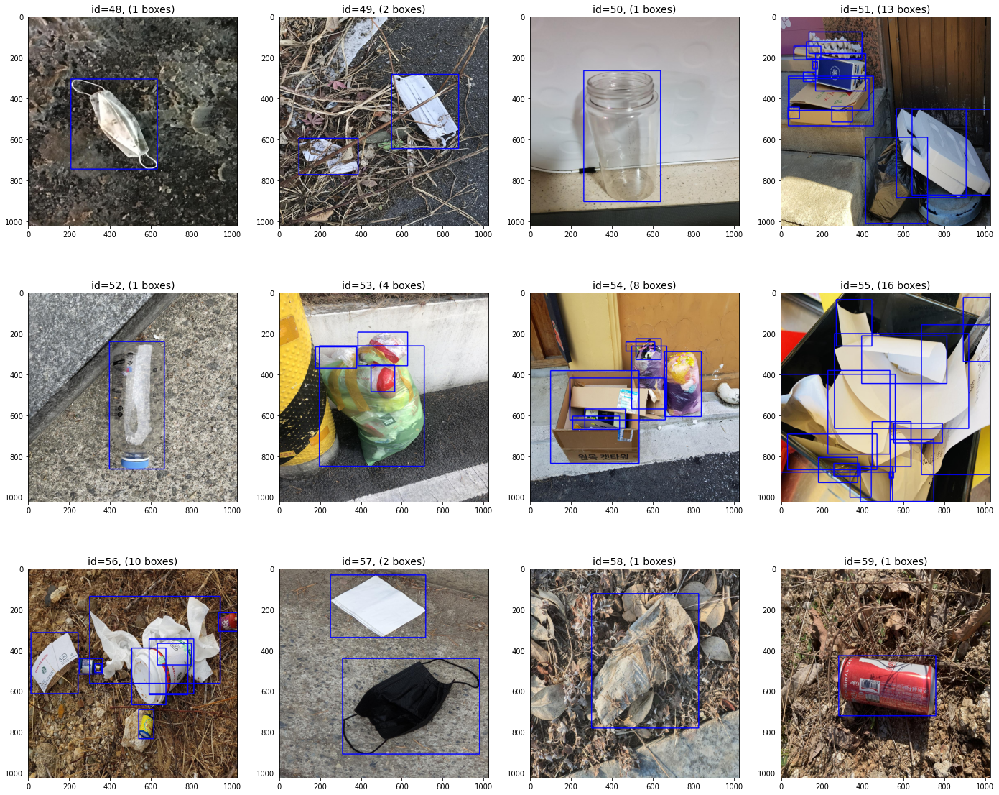

In [68]:
sample_id = range(48,60)
image_with_bbox_by_12_id(sample_id)

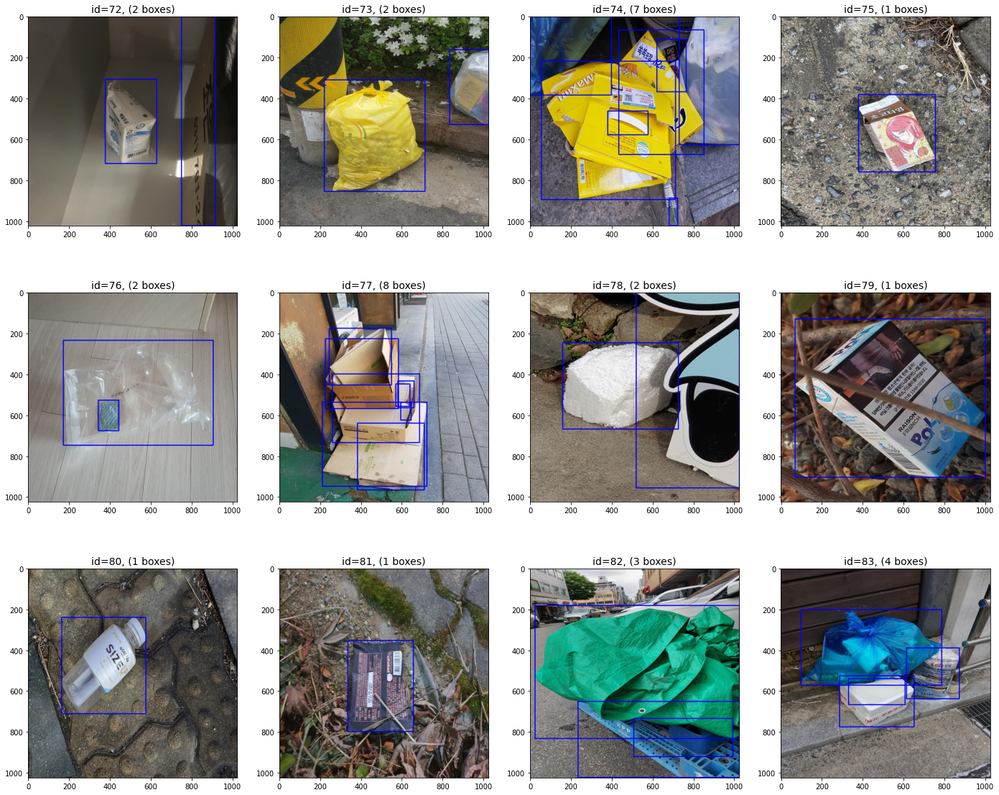

In [70]:
sample_id = range(72,84)
image_with_bbox_by_12_id(sample_id)

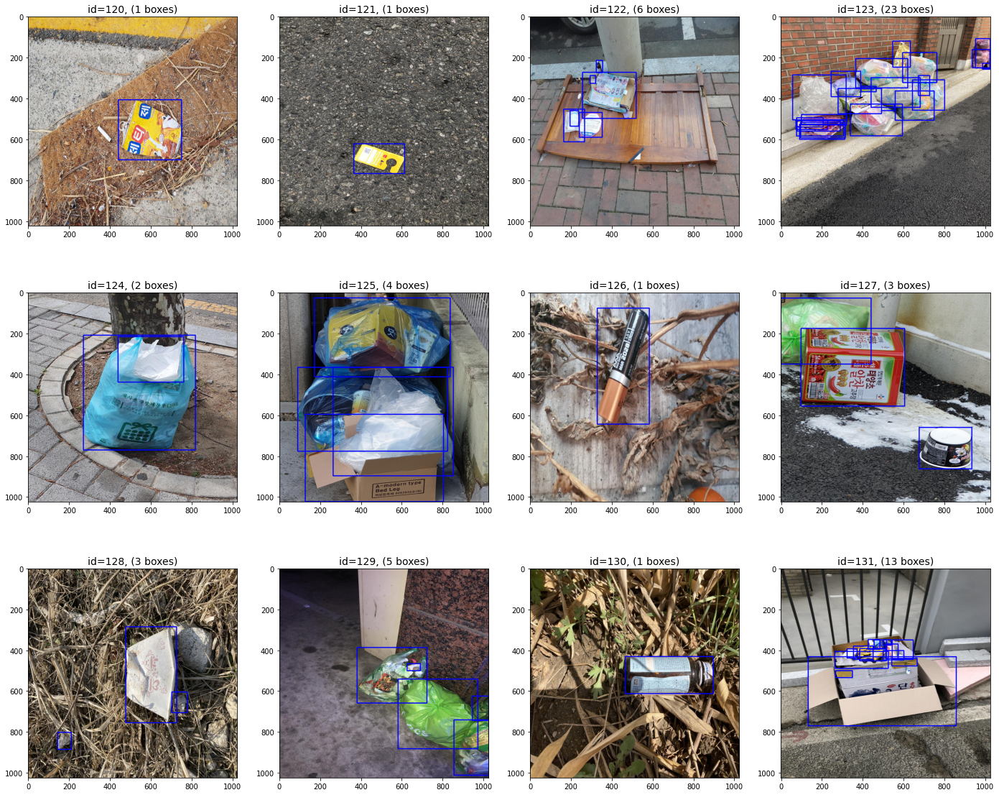

In [95]:
sample_id = range(120,132)
image_with_bbox_by_12_id(sample_id)

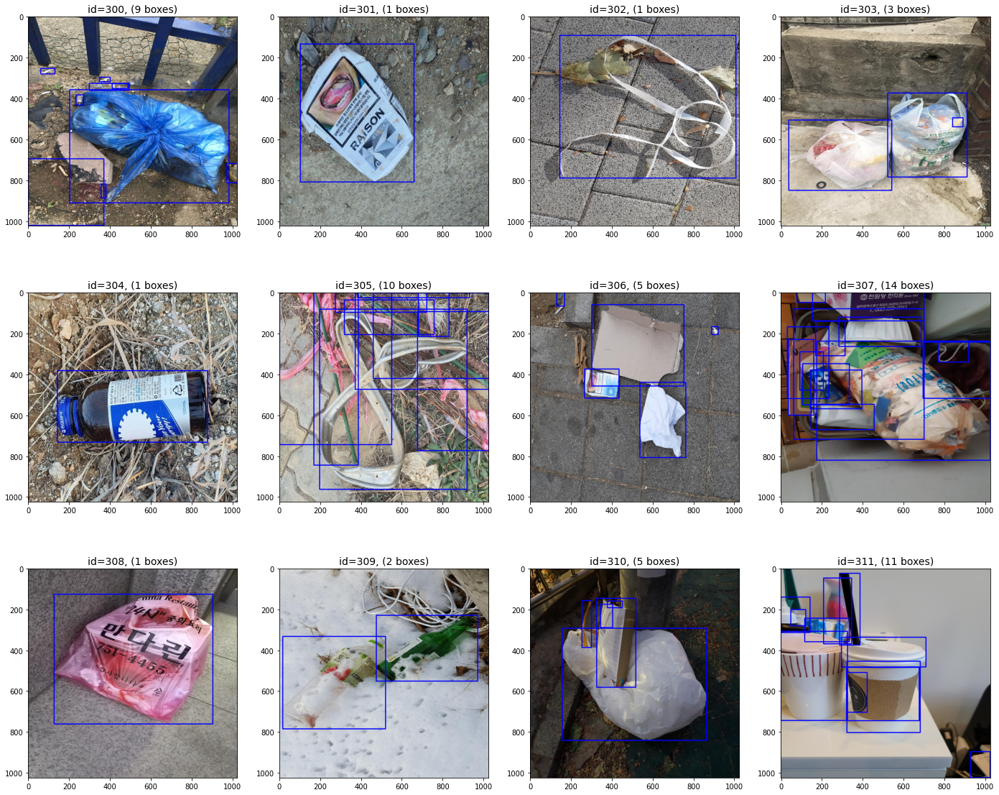

In [109]:
sample_id = range(300,312)
image_with_bbox_by_12_id(sample_id)

# 예상되는 문제점 : 어두운 객체
- 밤과 낮의 사진 밝기 차이가 모델 학습에 어떤 영향을?
    - 객체가 어두워 detect하기 어려울 수도 있지만 
    - 밝기가 다양한 환경에서 학습하면 보다 robust한 모델이 될 수도 있을 것 같음. 
- 한 이미지 내에서 그늘진 부분이 존재한다든지, 조명 때문에 일부 영역만 밝은 이미지처럼 전체적으로 영역들의 밝기가 고르지 않는 경우
    - 전체적인 영역의 contrast를 조정하는 것보다 CLAHE를 이용해서 contrast를 augmentation 시도해봄. 


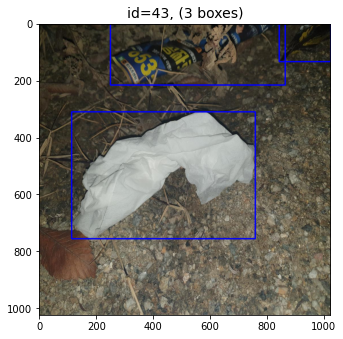

In [9]:
image_with_bbox_by_12_id(range(43, 44))

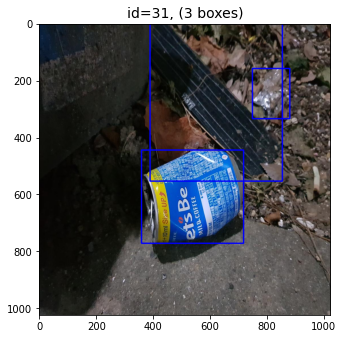

In [30]:
image_with_bbox_by_12_id(range(31, 32))

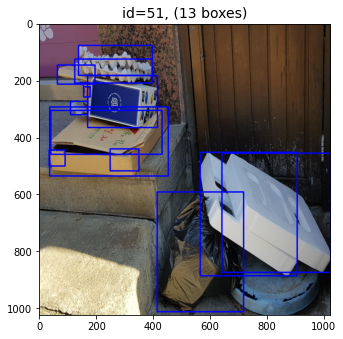

In [8]:
image_with_bbox_by_12_id(range(51, 52)) # 이미지 내부에 밝은 부분과 어두운 부분 동시에 존재

True

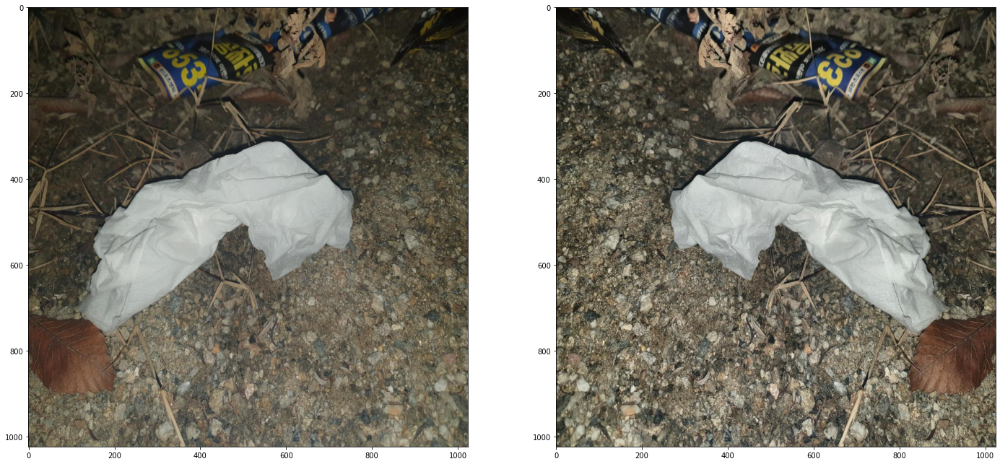

In [100]:
import albumentations as A
dataset_root = '/opt/ml/detection/dataset/train/'

# Declare an augmentation pipeline
transform = A.Compose([
    A.CLAHE(clip_limit=2.0,p=1.0),
    A.HorizontalFlip(p=0.5),
    #A.RandomBrightnessContrast(p=1,brightness_limit=[0.1, 0.2],contrast_limit=[0.1, 0.2],),
])

# Read an image with OpenCV and convert it to the RGB colorspace
image = cv2.imread(os.path.join(dataset_root,'0043.jpg'))
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Augment an image
transformed = transform(image=image)
transformed_image = transformed["image"]
fig = plt.figure(figsize=(24,20))
fig.add_subplot(1,2,1)
plt.imshow(image)
fig.add_subplot(1,2,2)
plt.imshow(transformed_image)
transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_RGB2BGR)
cv2.imwrite('/opt/ml/detection/dataset/augmented_train/'+'augmented_0043.jpg',transformed_image)

True

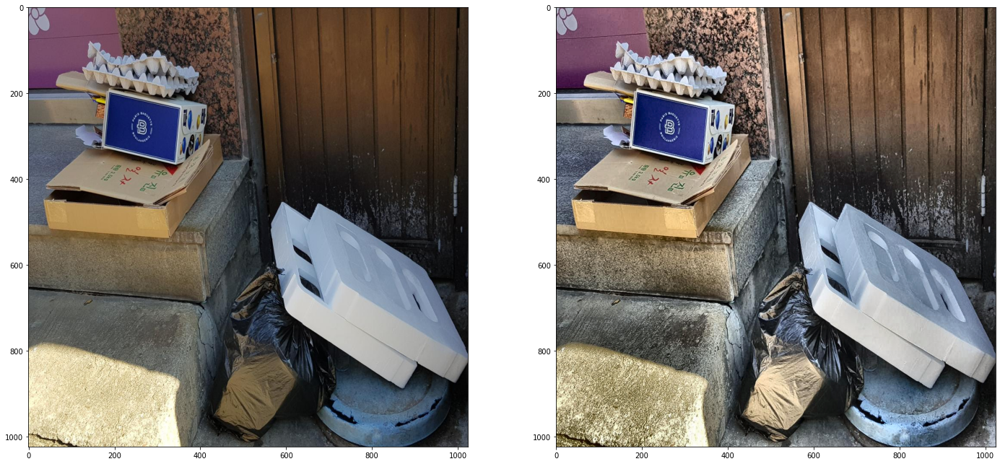

In [101]:
# Declare an augmentation pipeline
transform = A.Compose([
    A.CLAHE(clip_limit=4.0,p=1.0),
    #A.HorizontalFlip(p=0.5),
    #A.RandomBrightnessContrast(p=1,brightness_limit=[0.1, 0.2],contrast_limit=[0.1, 0.2],),
])

# Read an image with OpenCV and convert it to the RGB colorspace
image = cv2.imread(os.path.join(dataset_root,'0051.jpg'))
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Augment an image
transformed = transform(image=image)
transformed_image = transformed["image"]
fig = plt.figure(figsize=(24,20))
fig.add_subplot(1,2,1)
plt.imshow(image)
fig.add_subplot(1,2,2)
plt.imshow(transformed_image)
transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_RGB2BGR)
cv2.imwrite('/opt/ml/detection/dataset/augmented_train/'+'augmented_0051.jpg',transformed_image)

True

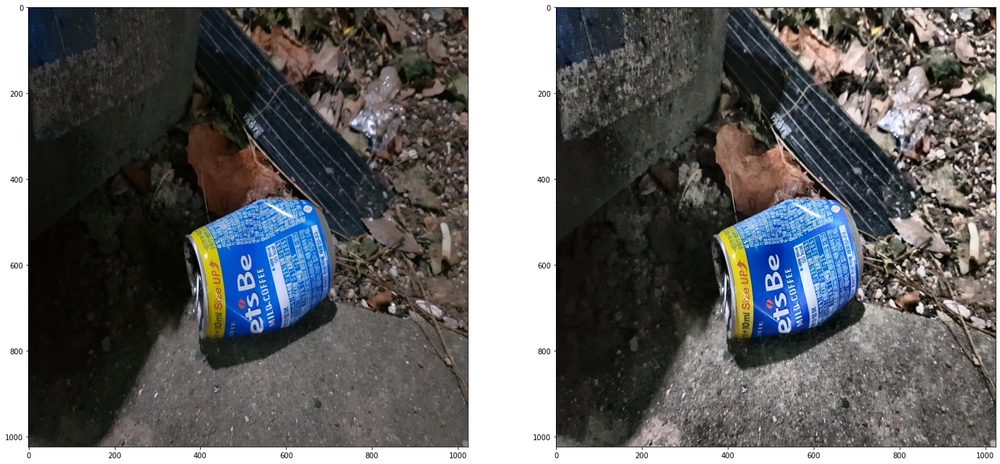

In [103]:
# Declare an augmentation pipeline
transform = A.Compose([
    A.CLAHE(clip_limit=4, p=1.0),
    A.HorizontalFlip(p=0.2),
   #A.RandomBrightnessContrast(p=1,brightness_limit=[0.1, 0.3],contrast_limit=[0.1, 0.2],),
])

# Read an image with OpenCV and convert it to the RGB colorspace
image = cv2.imread(os.path.join(dataset_root,'0031.jpg'))
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Augment an image
transformed = transform(image=image)
transformed_image = transformed["image"]
fig = plt.figure(figsize=(24,20))
fig.add_subplot(1,2,1)
plt.imshow(image)
fig.add_subplot(1,2,2)
plt.imshow(transformed_image)
transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_RGB2BGR)
cv2.imwrite('/opt/ml/detection/dataset/augmented_train/'+'augmented_0031.jpg',transformed_image)

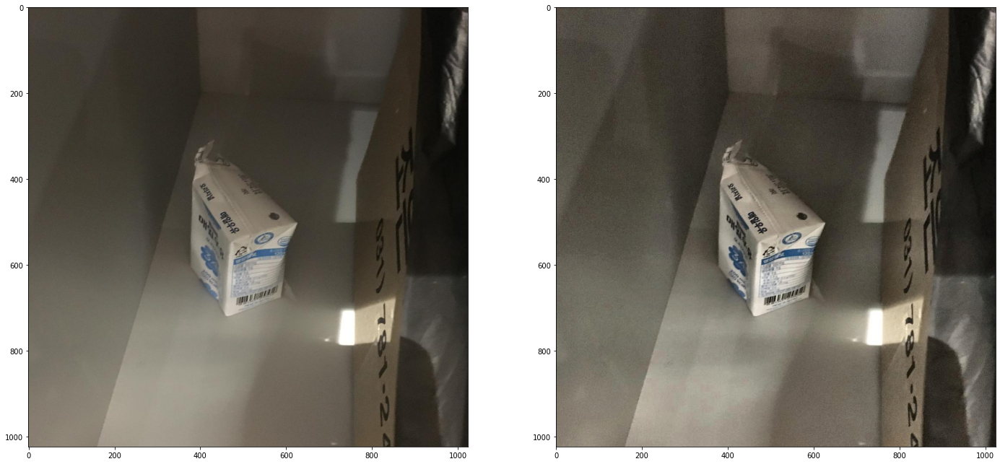

In [98]:
# Declare an augmentation pipeline
transform = A.Compose([
    A.CLAHE(clip_limit=2,p=1.0),
    A.HorizontalFlip(p=0.2),
    # A.RandomBrightnessContrast(p=1,brightness_limit=[0.1, 0.3],contrast_limit=[0.1, 0.2],
    #                           ),
])

# Read an image with OpenCV and convert it to the RGB colorspace
image = cv2.imread(os.path.join(dataset_root,'0072.jpg'))
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Augment an image
transformed = transform(image=image)
transformed_image = transformed["image"]
fig = plt.figure(figsize=(24,20))
fig.add_subplot(1,2,1)
plt.imshow(image)
fig.add_subplot(1,2,2)
plt.imshow(transformed_image)
# transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_RGB2BGR)
# cv2.imwrite('/opt/ml/detection/dataset/augmented_train/'+'augmented_0031.jpg',transformed_image)

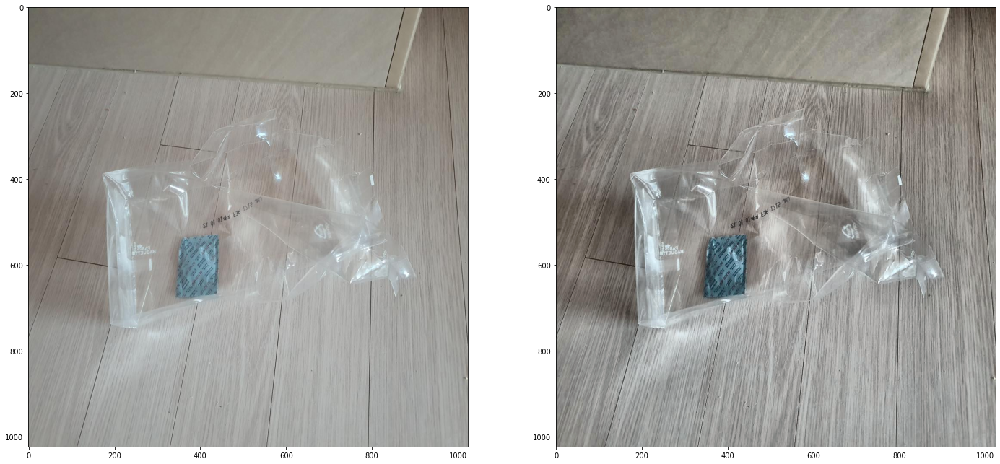

In [116]:
# Declare an augmentation pipeline
transform = A.Compose([
    A.CLAHE(clip_limit=2,p=1.0),
    A.HorizontalFlip(p=0.2),
    # A.RandomBrightnessContrast(p=1,brightness_limit=[0.1, 0.3],contrast_limit=[0.1, 0.2],
    #                           ),
])

# Read an image with OpenCV and convert it to the RGB colorspace
image = cv2.imread(os.path.join(dataset_root,'0076.jpg'))
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Augment an image
transformed = transform(image=image)
transformed_image = transformed["image"]
fig = plt.figure(figsize=(24,20))
fig.add_subplot(1,2,1)
plt.imshow(image)
fig.add_subplot(1,2,2)
plt.imshow(transformed_image)
# transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_RGB2BGR)
# cv2.imwrite('/opt/ml/detection/dataset/augmented_train/'+'augmented_0031.jpg',transformed_image)

In [45]:
import mmcv
from mmcv import Config
from mmdet.datasets import (build_dataloader, build_dataset,
                            replace_ImageToTensor)
from mmdet.models import build_detector
from mmdet.apis import single_gpu_test
from mmcv.runner import load_checkpoint
import os
from mmcv.parallel import MMDataParallel
import pandas as pd
from pandas import DataFrame
from pycocotools.coco import COCO
import numpy as np

## annotation파일 못 만들어서 보류

In [46]:
classes = ("General trash", "Paper", "Paper pack", "Metal", "Glass", 
           "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing")

# config file 들고오기
cfg = Config.fromfile('/opt/ml/detection/mmdetection/configs/boost_swint_faster_rcnn/final_swint.py')

root='/opt/ml/detection/dataset/'

epoch = 'epoch_32'

# dataset config 수정
# cfg.data.test.classes = classes
cfg.data.test.img_prefix = root + 'augmented_train'
# cfg.data.test.ann_file = root + 'test.json'
# cfg.data.test.pipeline[1]['img_scale'] = (1024,1024) # Resize
cfg.data.test.test_mode = True

# cfg.data.samples_per_gpu = 4

# cfg.seed=2021
# cfg.gpu_ids = [1]
cfg.work_dir = '/opt/ml/detection/mmdetection/work_dirs/test_for_hooks'

#cfg.model.roi_head.bbox_head.num_classes = 10

# cfg.optimizer_config.grad_clip = dict(max_norm=35, norm_type=2)
# cfg.model.train_cfg = None

In [47]:
dataset = build_dataset(cfg.data.test)
data_loader = build_dataloader(
        dataset,
        samples_per_gpu=1,
        workers_per_gpu=cfg.data.workers_per_gpu,
        dist=False,
        shuffle=False)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
